# Abalone
Data: http://archive.ics.uci.edu/ml/datasets/Abalone

Predicting the age of abalone from physical measurements.  The age of abalone is determined by cutting the shell through the cone, staining it, and counting the number of rings through a microscope -- a boring and time-consuming task.  Other measurements, which are easier to obtain, are used to predict the age.  Further information, such as weather patterns and location (hence food availability) may be required to solve the problem.

### Columns


	Sex		nominal			M, F, and I (infant)
	Length		continuous	mm	Longest shell measurement
	Diameter	continuous	mm	perpendicular to length
	Height		continuous	mm	with meat in shell
	Whole weight	continuous	grams	whole abalone
	Shucked weight	continuous	grams	weight of meat
	Viscera weight	continuous	grams	gut weight (after bleeding)
	Shell weight	continuous	grams	after being dried
	Rings		integer			+1.5 gives the age in years

In [7]:
import os
import pandas as pd
import numpy as np

import warnings 
warnings.filterwarnings("ignore")

In [3]:
columns = (['Sex','Length','Diameter', 'Height', 'Whole weight', 'Shucked weight', 'Viscera weigth', 'Shell weigth', 'Rings'])
data = pd.read_csv(os.path.join("data", "abalone.data"), header=None, names=columns)

In [4]:
data.head(5)

,Sex,Length,Diameter,Height,Whole weight,Shucked weight,Viscera weigth,Shell weigth,Rings
0,M,0.455,0.365,0.095,0.5140,0.2245,0.1010,0.150,15
1,M,0.350,0.265,0.090,0.2255,0.0995,0.0485,0.070,7
2,F,0.530,0.420,0.135,0.6770,0.2565,0.1415,0.210,9
3,M,0.440,0.365,0.125,0.5160,0.2155,0.1140,0.155,10
4,I,0.330,0.255,0.080,0.2050,0.0895,0.0395,0.055,7


In [5]:
data.describe()

,Length,Diameter,Height,Whole weight,Shucked weight,Viscera weigth,Shell weigth,Rings
count,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000,4177.000000
mean,0.523992,0.407881,0.139516,0.828742,0.359367,0.180594,0.238831,9.933684
std,0.120093,0.099240,0.041827,0.490389,0.221963,0.109614,0.139203,3.224169
min,0.075000,0.055000,0.000000,0.002000,0.001000,0.000500,0.001500,1.000000
25%,0.450000,0.350000,0.115000,0.441500,0.186000,0.093500,0.130000,8.000000
50%,0.545000,0.425000,0.140000,0.799500,0.336000,0.171000,0.234000,9.000000
75%,0.615000,0.480000,0.165000,1.153000,0.502000,0.253000,0.329000,11.000000
max,0.815000,0.650000,1.130000,2.825500,1.488000,0.760000,1.005000,29.000000


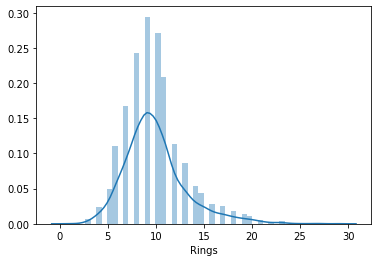

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.distplot(data["Rings"])

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x0000024EFE773A88>,
      dtype=object)

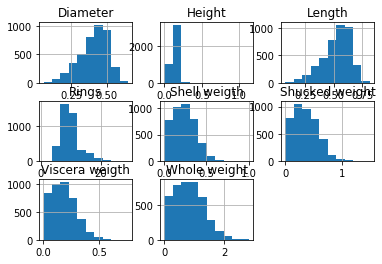

In [9]:
data.hist()

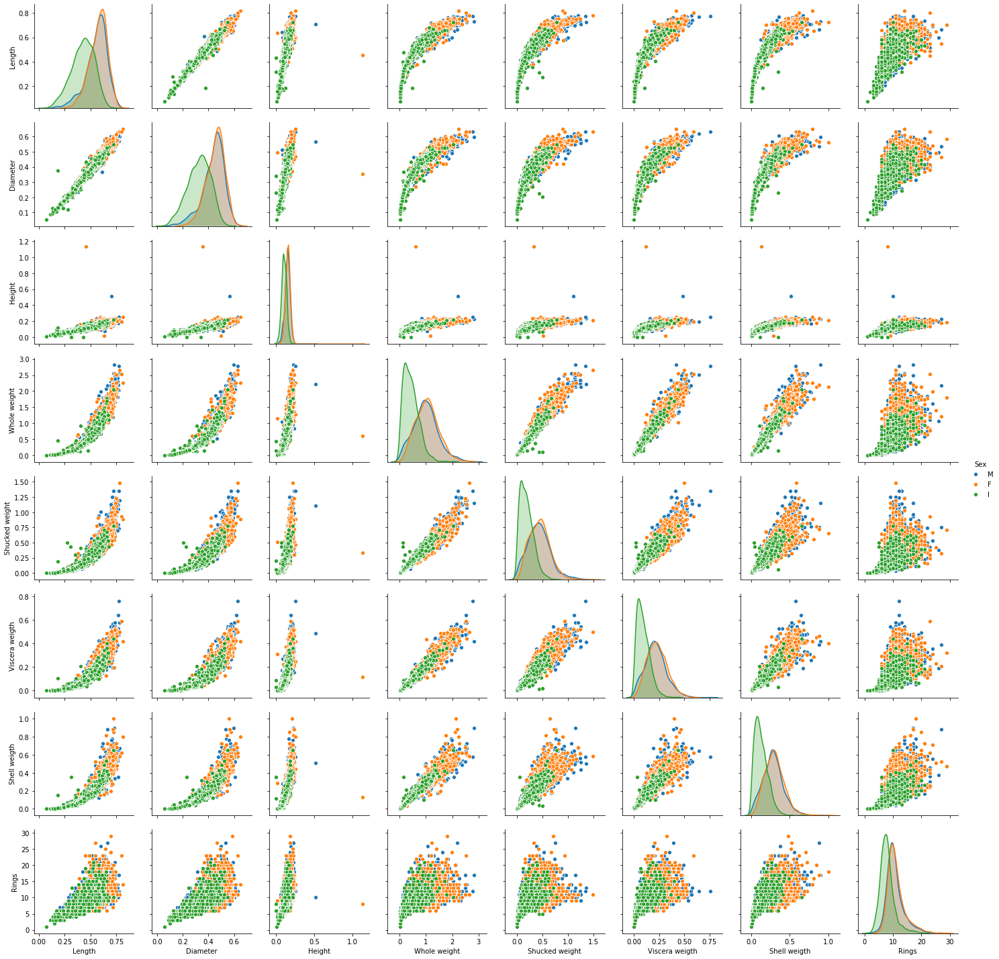

In [10]:
sns.pairplot(data, hue='Sex')

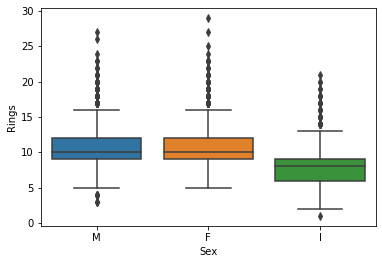

In [11]:
sns.boxplot(x="Sex", y="Rings", data=data)

In [12]:
from sklearn.model_selection import train_test_split

y = data['Rings']
X = data.drop(columns=['Sex', 'Rings'])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

In [14]:
X_train.head(5)

,Length,Diameter,Height,Whole weight,Shucked weight,Viscera weigth,Shell weigth
2746,0.485,0.365,0.140,0.4475,0.1895,0.0925,0.2305
853,0.570,0.455,0.150,0.9520,0.3895,0.2155,0.2745
1809,0.640,0.475,0.140,1.0725,0.4895,0.2295,0.3100
3419,0.590,0.470,0.135,1.1685,0.5390,0.2790,0.2800
1199,0.720,0.580,0.195,2.1030,1.0265,0.4800,0.5375


## Scaling

In [16]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(X_train)
X_scaled = scaler.transform(X_train)

In [18]:
X_scaled

array([[-0.33255887, -0.44033187,  0.00270125, ..., -0.77101473,
        -0.80982999, -0.06477737],
       [ 0.37806364,  0.47097234,  0.23711333, ...,  0.13127411,
         0.31172689,  0.25225995],
       [ 0.96328218,  0.67348439,  0.00270125, ...,  0.58241854,
         0.43938377,  0.50805143],
       ...,
       [ 0.50346761,  0.42034433,  0.94034958, ..., -0.11008815,
         0.03817643, -0.01794231],
       [ 0.41986496,  0.52160036,  0.58873146, ...,  0.62302153,
         0.30260854,  0.30269771],
       [ 0.83787821,  0.67348439,  0.47152542, ...,  1.10349034,
         0.96824799,  0.57289997]])

In [19]:
X_scaled.shape

(3341, 7)

## Linear Regression

In [23]:
from sklearn.linear_model import LinearRegression

linearRegression = LinearRegression()
linearRegression.fit(X_scaled, y_train)

y_pred = linearRegression.predict(scaler.transform(X_test))

In [28]:
from sklearn.metrics import mean_squared_error, r2_score

print('Mean Squared Error\t:\t{0:.4f}'.format(mean_squared_error(y_test, y_pred)))
print('R2\t\t\t:\t{0:.4f}'.format(r2_score(y_test, y_pred)))

Mean Squared Error	:	4.6163
R2			:	0.5369


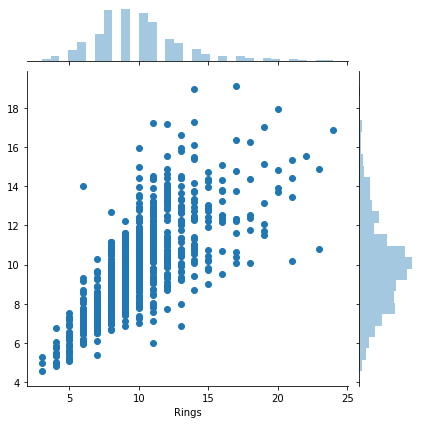

In [29]:
sns.jointplot(y_test, y_pred)

## KNeighborsClassifier

In [31]:
from sklearn.neighbors import KNeighborsClassifier

kNeighborsClassifier = KNeighborsClassifier(n_neighbors=1)
kNeighborsClassifier.fit(X_train, y_train)
kNeighborsClassifier.score(X_test, y_test)

0.19258373205741627

In [32]:
kNeighborsClassifier.classes_

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 29], dtype=int64)

## KNeighborsRegressor

In [33]:
from sklearn.neighbors import KNeighborsRegressor

train_score, test_score = [], []
n_values = range(1, 40)

for n in n_values:
    knn = KNeighborsRegressor(n_neighbors=n)
    knn.fit(X_train, y_train)
    train_score.append(knn.score(X_train, y_train))
    test_score.append(knn.score(X_test, y_test))
    print('K={0}'.format(n))
    print('Train score {0:.3f}'.format(knn.score(X_train, y_train)))
    print('Train score {0:.3f}'.format(knn.score(X_test, y_test)))

K=1
Train score 1.000
Train score 0.095
K=2
Train score 0.802
Train score 0.345
K=3
Train score 0.739
Train score 0.425
K=4
Train score 0.704
Train score 0.452
K=5
Train score 0.687
Train score 0.472
K=6
Train score 0.670
Train score 0.487
K=7
Train score 0.655
Train score 0.507
K=8
Train score 0.644
Train score 0.521
K=9
Train score 0.636
Train score 0.537
K=10
Train score 0.633
Train score 0.540
K=11
Train score 0.629
Train score 0.542
K=12
Train score 0.624
Train score 0.543
K=13
Train score 0.619
Train score 0.543
K=14
Train score 0.615
Train score 0.543
K=15
Train score 0.614
Train score 0.543
K=16
Train score 0.610
Train score 0.544
K=17
Train score 0.607
Train score 0.545
K=18
Train score 0.605
Train score 0.546
K=19
Train score 0.603
Train score 0.543
K=20
Train score 0.601
Train score 0.544
K=21
Train score 0.598
Train score 0.543
K=22
Train score 0.596
Train score 0.545
K=23
Train score 0.593
Train score 0.543
K=24
Train score 0.593
Train score 0.543
K=25
Train score 0.591
Tr

It is quite visible from this graph that the elbow of the regressor is at 4 neighbours.

Text(0, 0.5, 'Score')

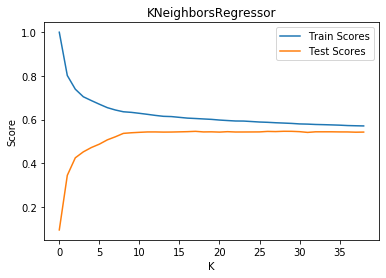

In [41]:
plt.plot(train_score, label="Train Scores")
plt.plot(test_score, label="Test Scores")
plt.legend()
plt.title("KNeighborsRegressor")
plt.xlabel("K")
plt.ylabel("Score")